In [0]:
import pandas as pd

In [0]:
import matplotlib.pyplot as plt

In [0]:
data = pd.read_csv('MWM_Assoc_Analytics_Day_1.csv')

In [0]:
clients = data['Client MAC']

In [0]:
len(clients)

192194

In [0]:
unq_clients = dict()

In [0]:
for id in clients:
  #unq_clients[id] = (unq_clients.get(id,0) + 1)
  if id not in unq_clients:
    unq_clients[id] = 1
  else:
    unq_clients[id] = unq_clients[id] + 1
print(len(unq_clients))

1383


In [0]:
unq_clients = list(unq_clients.keys())

In [0]:
devices = data['Smart Device Type']
unq_devices = dict()

In [0]:
for i in devices:
  if i not in unq_devices:
    unq_devices[i] = 1
  else:
    unq_devices[i] = unq_devices[i] + 1
print(len(unq_devices))
  

5


In [0]:
plt.plot(range(len(unq_devices)), unq_devices.values(),':')#, align='center')
plt.xticks(range(len(unq_devices)), list(unq_devices.keys()))
plt.xlabel('Device Type')
plt.ylabel('Data usage')
plt.scatter(list(unq_devices.keys()),unq_devices.values())
#plt.axis((0,5),(0,1000))
#plt.rcParams["figure.figsize"] = (20,20)
plt.show()

ValueError: ignored

<Figure size 72000x720 with 1 Axes>

In [0]:
data_usage = []
datain = data['Data Transferred To Device (Bytes)']
dataout = data['Data Transfer From Device (Bytes)']
for i in range(0,len(datain)):
  data_usage.append(int(datain[i] + dataout[i]))
data_usage
  

[75191334,
 2408535,
 1547341,
 29353336,
 5389424,
 362778,
 215475372,
 299764709,
 99914238,
 998718701,
 465580026,
 85414542,
 427348386,
 16710984,
 16951730,
 7099081,
 214990282,
 17961234,
 1500936015,
 5223317,
 880544,
 3934539978,
 108518149,
 632969931,
 25040791,
 21050352,
 101708622,
 97739665,
 3031554,
 3522461,
 2505619,
 9793276,
 93914291,
 51230762,
 725142036,
 10155543,
 30069529,
 2879147,
 78997839,
 3335700,
 4352543,
 25801469,
 251290293,
 28511338,
 49199332,
 10986714,
 455647447,
 661062640,
 98452426,
 6469848,
 3885872,
 4452279,
 30919199,
 1952408,
 217219419,
 1405755,
 425579,
 154070362,
 16523,
 1932276,
 1834868,
 54226472,
 491014281,
 162293836,
 122491730,
 496881814,
 5050388,
 38637768,
 19136599,
 158667385,
 2288423,
 12572341,
 12009320,
 3606974,
 11657856,
 47387423,
 29068372,
 79384369,
 65388974,
 571926373,
 24777197,
 6510073,
 117377487,
 32575933,
 36915,
 744088720,
 3627730,
 4322802204,
 3262577,
 2656811175,
 161086002,
 155

In [0]:
start_date = []
for i in data['Association Start Time Local']:
  #print(i,type(i))
  start_date.append((str(i))[:10])


In [0]:
print(start_date[len(start_date)-1])

04/27/2019


In [0]:
per_day_usage = dict()
k=0 #corresponding index of data_usage
for i in start_date:
  if i not in per_day_usage:
    per_day_usage[i] = data_usage[k]/1000000000
    k+=1
  else:
    per_day_usage[i] = per_day_usage[i] + data_usage[k]/1000000000
    k+=1
per_day_usage

{'01/01/1970': 1.994668941,
 '03/06/2019': 4.508864145,
 '03/14/2019': 2.054523497,
 '03/17/2019': 0.233656818,
 '03/18/2019': 16.116344946,
 '03/19/2019': 1.231247707,
 '03/20/2019': 0.24768677299999997,
 '03/21/2019': 27.437334637999996,
 '03/22/2019': 431.3819152939993,
 '03/23/2019': 391.18812405199947,
 '03/24/2019': 594.172262964,
 '03/25/2019': 910.7946160149995,
 '03/26/2019': 889.2353173189994,
 '03/27/2019': 776.1882547239992,
 '03/28/2019': 853.8989658680007,
 '03/29/2019': 864.9166337399988,
 '03/30/2019': 834.616550158001,
 '03/31/2019': 952.049050006998,
 '04/01/2019': 798.7490791160008,
 '04/02/2019': 742.749164393998,
 '04/03/2019': 903.2856813849991,
 '04/04/2019': 972.0789619550002,
 '04/05/2019': 838.7209692069986,
 '04/06/2019': 975.8296862500014,
 '04/07/2019': 939.0747362700012,
 '04/08/2019': 792.608864760999,
 '04/09/2019': 862.8921345640005,
 '04/10/2019': 918.4915580500001,
 '04/11/2019': 1051.1913928059987,
 '04/12/2019': 951.2597096869969,
 '04/13/2019': 880

In [0]:
plt.bar(range(len(per_day_usage)), per_day_usage.values(), align='center')
plt.xticks(range(len(per_day_usage)), list(per_day_usage.keys()),rotation = 'vertical')
plt.rcParams["figure.figsize"] = (20,8)
plt.show()

ValueError: ignored

<Figure size 72000x720 with 1 Axes>

In [0]:
per_device_data_usage = dict()
k = 0#same purpose as above
for id in clients:
  if id not in per_device_data_usage:
    per_device_data_usage[id] = data_usage[k]/1000000000
    k+=1
  else:
    per_device_data_usage[id] = per_device_data_usage[id] + data_usage[k]/1000000000
    k+=1
len(per_device_data_usage)

1383

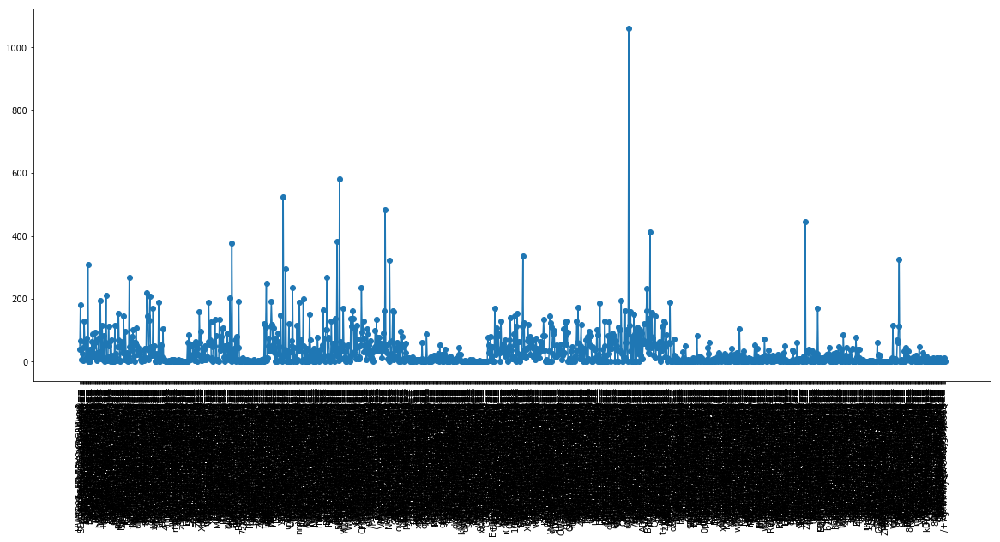

In [0]:
plt.plot(range(len(per_device_data_usage)), per_device_data_usage.values())#, align='center')
plt.xticks(range(len(per_device_data_usage)), list(per_device_data_usage.keys()),rotation = 'vertical')
plt.scatter(list(per_device_data_usage.keys()),per_device_data_usage.values())
plt.rcParams["figure.figsize"] = (1000,10)
plt.show()

In [0]:
ap = data['Protocol']

In [0]:
data_usage_per_ap = dict()
k = 0#same old
for i in ap:
  if i not in data_usage_per_ap:
    data_usage_per_ap[i] = data_usage[k]/1000000000
    k+=1
  else:
    data_usage_per_ap[i] = data_usage_per_ap[i] + data_usage[k]/1000000000
    k+=1
data_usage_per_ap

{1: 12178.996448132051, 6: 13568.128762981907, 7: 21702.114642340104}

In [0]:
'''plt.bar(range(len(data_usage_per_ap)), data_usage_per_ap.values(), align='center')
plt.xticks(range(len(data_usage_per_ap)), list(data_usage_per_ap.keys()))
plt.rcParams["figure.figsize"] = (3,3)
plt.show()'''

plt.pie(data_usage_per_ap.values(),labels = data_usage_per_ap.keys(), autopct='%1.1f%%')
plt.title('Data Usage Per Protocol')
plt.show()

ValueError: ignored

<Figure size 72000x720 with 1 Axes>

In [0]:
connec_per_ap = dict()
for i in ap:
  if i not in connec_per_ap:
    connec_per_ap[i] = 1
  else:
    connec_per_ap[i] = connec_per_ap[i] + 1
connec_per_ap

{1: 34459, 6: 74710, 7: 83025}

In [0]:
data_rate = data['Data Rate (kbps)']
avg_data_rate_per_ap = dict()
k = 0
for i in ap:
  if i not in avg_data_rate_per_ap:
    avg_data_rate_per_ap[i] = data_rate[k]/1024
    k+=1
  else:
    avg_data_rate_per_ap[i] = avg_data_rate_per_ap[i] + int(data_rate[k]/1024)
    k+=1
for i in connec_per_ap:
  avg_data_rate_per_ap[i] = int(avg_data_rate_per_ap[i]/connec_per_ap[i])
avg_data_rate_per_ap

{1: 336, 6: 45, 7: 120}

In [0]:
plt.bar(range(len(avg_data_rate_per_ap)), avg_data_rate_per_ap.values(), align='center')
plt.xticks(range(len(avg_data_rate_per_ap)), list(avg_data_rate_per_ap.keys()))
plt.rcParams["figure.figsize"] = (3,3)
plt.show()

ValueError: ignored

<Figure size 72000x720 with 1 Axes>

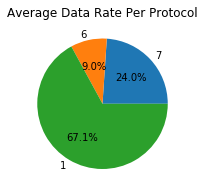

In [0]:
plt.pie(avg_data_rate_per_ap.values(),labels = avg_data_rate_per_ap.keys(), autopct='%1.1f%%')
plt.title('Average Data Rate Per Protocol')
#fig = plt.figure(1, figsize=(8, 14), frameon=False, dpi=100)
plt.show()

In [0]:
sites_per_user = dict()
sites = data['Domains Accessed']
k = 0
for i in clients:
  if i not in sites_per_user:
    sites_per_user[i] = str(sites[k])
    #print(sites[k],type(sites[k]))
    k+=1
  else:
    sites_per_user[i] = str(sites_per_user[i]) + '|' + str(sites[k])
    k+=1
#sites_per_user

In [0]:
for i in sites_per_user:
  #print(type(sites_per_user[i]))
  sites_per_user[i] = (sites_per_user[i]).split('|')
#sites_per_user


In [0]:
for i in sites_per_user:
  for j in range(0,len(sites_per_user[i])):
    #print(((sites_per_user[i])[j]))
    h = (sites_per_user[i])[j]
    k = h.find('(')
    (sites_per_user[i])[j] = h[:k]

In [0]:
visited_sites = dict()
for i in sites_per_user:
  for j in range(0,len(sites_per_user[i])):
    h =((sites_per_user[i])[j])[:((sites_per_user[i])[j]).find('.')]
    if h:
      if h not in visited_sites:
        visited_sites[h] = 1
      else:
        visited_sites[h] = visited_sites[h] + 1
#visited_sites
    

In [0]:
y = []
z = visited_sites
for key in z:
  if z[key]< 75000:
    y.append(key)
for i in y:
  z.pop(i,None)

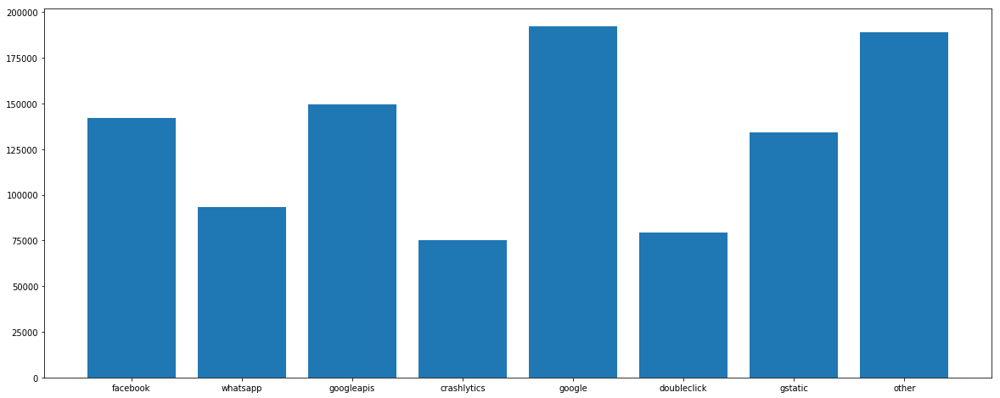

In [0]:

plt.bar(range(len(z)), z.values(), align='center')
plt.xticks(range(len(z)), list(z.keys()))
plt.rcParams["figure.figsize"] = (40,8)
#plt.autoscale(enable=True,axis='both',tight=None)
plt.show()

In [0]:
ssid = data['SSID']
guests = dict()
temp = dict()
k = 0
guests['Guests'] = 0
guests['IITJMU_Family'] = 0
for i in clients:
  #print('i in clients = ', i)
  if i not in temp:
    #print('i not in temp = ', i)
    temp[i] = 'ok'
    if ssid[k] == 'IITJMU_Guest':
      guests['Guests'] = guests['Guests'] + 1
    else:
      guests['IITJMU_Family'] = guests['IITJMU_Family'] + 1
    k += 1
  
  
print(len(temp))    
temp.clear()
guests
  

1383


{'Guests': 10, 'IITJMU_Family': 1373}

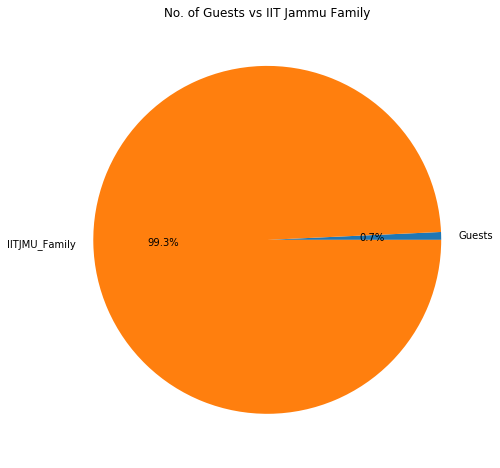

In [0]:
plt.pie(guests.values(),labels=guests.keys(),autopct='%1.1f%%')
plt.title('No. of Guests vs IIT Jammu Family')
plt.show()

In [0]:

session = data['Session Duration']
session[0]

'01:29:35'

In [0]:
for i in range(len(session)):
  if (session[i]).find('-')>-1:
    session[i] = (session[i])[(session[i].find(' ')+1):]
  if (session[i]).find('-')>-1:
    session[i] = '0:30:45'
  #(session[i]).replace(':','.')

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  This is separate from the ipykernel package so we can avoid doing imports until
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """


In [0]:


ssn=[]
k = 0
for i in session:
  #print(i)
  h = str(i)
  j = h.split(':')
  #print(j)
  ssn.append(int(j[0])*3600 + int(j[1])*60 + int(j[2]))
  

In [0]:
ssn_dur = dict()
user_session = dict()
k = 0  
'''p = dict()
for i in clients:
  if i not in user_session:
    #for j in start_date:
      #if j not in ssn_dur:
    ssn_dur[start_date[k]] = ssn[k]/3600
    user_session[i] = (start_date[k],ssn_dur[start_date[k]])
    k += 1
  else:
    if start_date[k] in ssn_dur:
      ssn_dur[start_date[k]] = ssn_dur[start_date[k]]+ssn[k]/3600
      user_session[i] = {start_date[k]:(ssn_dur[start_date[k]])}
      k += 1
      
print(ssn_dur)'''   
for i in unq_clients:
  for j in range(len(start_date)):
    if clients[j] == i:
      if start_date[j] not in user_session:
        user_session[start_date[j]] = ssn[j]/3600
      else:
        user_session[start_date[j]] = user_session[start_date[j]] + ssn[j]/3600
  ssn_dur[i] = user_session
  print(ssn_dur)
  user_session.clear()
#ssn_dur
  

{'HW6B37gcPL7EVOKOGlW+eA==': {'04/23/2019': 9.303333333333333, '04/24/2019': 6.988333333333334, '04/04/2019': 8.691666666666666, '04/05/2019': 7.450277777777778, '04/03/2019': 8.146944444444445, '04/01/2019': 7.256944444444444, '04/02/2019': 7.023888888888889, '04/06/2019': 7.319444444444444, '04/07/2019': 5.4025, '04/08/2019': 7.176111111111111, '04/29/2019': 5.9575, '04/30/2019': 8.342222222222222, '03/28/2019': 8.516666666666666, '03/29/2019': 4.894722222222223, '04/10/2019': 7.597777777777778, '04/11/2019': 5.161944444444444, '05/03/2019': 12.378333333333334, '05/04/2019': 9.200277777777778, '04/12/2019': 5.605833333333335, '03/30/2019': 9.510555555555555, '04/09/2019': 7.1722222222222225, '04/15/2019': 11.314722222222219, '04/16/2019': 7.554166666666667, '03/31/2019': 4.793611111111111, '04/13/2019': 8.210833333333333, '04/14/2019': 6.8308333333333335, '04/17/2019': 9.679722222222223, '04/18/2019': 6.322222222222223, '04/27/2019': 6.239166666666667, '04/28/2019': 4.928611111111111

KeyboardInterrupt: ignored